# Introduction

In the previous sessions, you learned how to construct scientometric networks in Python. It was clear that this can be quite challenging. VOSviewer takes care of a lot of the necessary work in creating scientometric networks. You can hence use VOSviewer to create networks, which you could then export and analyse further in Python. We will here take this approach.

## VOSviewer

You have previously constructed scientometric networks using VOSviewer. You can import the resulting network for further analysis in `igraph`. In order to import the file in `igraph` you need to have saved both the `map` file and the `network` file in VOSviewer. See the manual of VOSviewer for more explanation. As in the previous Python notebook, we have prepared some files for you, in this case the author collaboration network from the Web of Science files that we analysed previously.

We first import the necessary packages. You will presumably recognize these still from the previous Python notebook.

In [1]:
import pandas as pd
import igraph as ig

Now let us read the map and network file from VOSviewer.

<div class="alert alert-info">
    Read the file <code>data-files/vosviewer/vosviewer_map.txt</code> using tabs (<code>'\t'</code>) as a field separator, and call the resulting variable <code>map_df</code>.
</div>

In [2]:
map_df = pd.read_csv('data-files/vosviewer/vosviewer_map.txt', sep='\t')

The network file from VOSviewer has no header, so we set it manually

In [3]:
network_df = pd.read_csv('data-files/vosviewer/vosviewer_network.txt', sep='\t', header=None,
                         names=['idA', 'idB', 'weight'])

Now we have loaded the data, so we can simply construct a network as before.

In [4]:
G_vosviewer = ig.Graph.DictList(
      vertices=map_df.to_dict('records'),
      edges=network_df.to_dict('records'),
      vertex_name_attr='id',
      edge_foreign_keys=('idA', 'idB'),
      directed=False
      )

The layout and clustering is also stored by VOSviewer, and we can use that to display the same visualization in `igraph`.

In [5]:
layout = ig.Layout(coords=zip(*[G_vosviewer.vs['x'], G_vosviewer.vs['y']]))
clustering = ig.VertexClustering.FromAttribute(G_vosviewer, 'cluster')

ig.plot(clustering, layout=layout, vertex_size=4, vertex_frame_width=0, vertex_label=None)

## Clustering

A common phenomenon in many networks is the presence of group structure, where nodes within the same group are densely connected. Such a structure is sometimes called a *modular* structure, and a frequently used measure of group structure is known as *modularity*. You have already encountered this functionality briefly in VOSviewer, which provides clusters. Here we will explore this a bit more in-depth.

First, we will import a package called `leidenalg` which is the *Leiden algorithm*, which we will use for clustering. It is built on top of `igraph` so that it easily integrates with all the exisiting methods of `igraph`.

In [6]:
import leidenalg

Now let us find clusters in the collaboration network from VOSviewer, using the weight of the edges. Because the algorithm is stochastic, it may yield somewhat different results every time you run it. To prevent that from happening, and to always get the same result, we will set the random seed to 0. The result is a `VertexClustering`, which we already briefly encountered when using the clustering results from VOSviewer.

We will first find clusters using *modularity*.

In [7]:
optimiser = leidenalg.Optimiser()
optimiser.set_rng_seed(0)
clusters = leidenalg.ModularityVertexPartition(G_vosviewer, weights='weight')
optimiser.optimise_partition(clusters)

0.803206011123529

The length of the `clusters` variable indicates the number of clusters.

In [8]:
len(clusters)

32

When accessing `clusters` variable as a list, each element corresponds to the set of nodes in that cluster.

<div class="alert alert-info">
    What are the nodes in cluster <code>30</code>?
</div>

In [9]:
clusters[30]

[548, 1052, 1075, 1226, 2155]

Hence, node `548`, node `1052`, etc... belong to cluster `30`. Another way to look at the clusters is by looking at the `membership` of `clusters`.

<div class="alert alert-info">
    What is the membership of the first 10 nodes?
</div>

In [10]:
clusters.membership[:10]

[7, 9, 4, 3, 8, 6, 0, 8, 7, 8]

Hence, node `0` belongs to cluster `7`, node `1` belongs to cluster `9`, node `2` belongs to cluster `4`, et cetera.

Let us take a closer look at the largest cluster.

In [11]:
H = clusters.giant()
print(H.summary())

IGRAPH U-W- 308 2046 -- 
+ attr: cluster (v), id (v), label (v), score<Avg. citations> (v), score<Avg. norm. citations> (v), score<Avg. pub. year> (v), weight<Citations> (v), weight<Documents> (v), weight<Links> (v), weight<Norm. citations> (v), weight<Total link strength> (v), x (v), y (v), idA (e), idB (e), weight (e)


We could again detect clusters using modularity in the largest cluster.

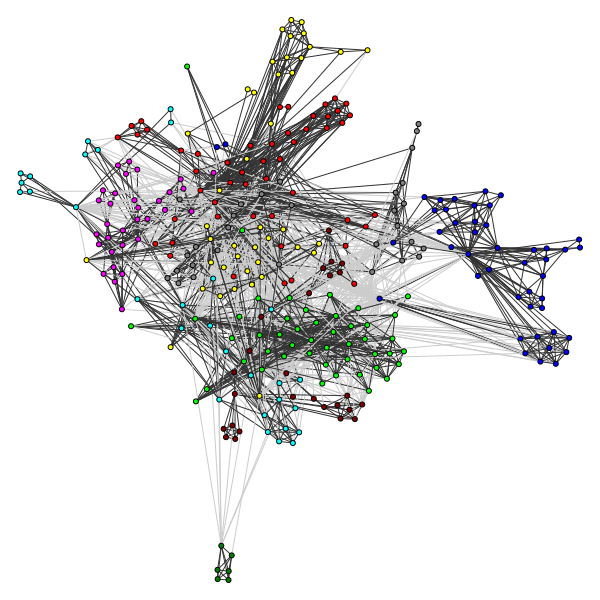

In [12]:
optimiser.set_rng_seed(0)
subclusters = leidenalg.ModularityVertexPartition(H, weights='weight')
optimiser.optimise_partition(subclusters)
ig.plot(subclusters, vertex_size=5, vertex_label=None)

In general, modularity will continue to find subclusters in this way. An alternative approach, called CPM, does not suffer from that problem. 

Let us detect clusters using CPM. We do have to specify a parameter, called the `resolution_parameter`. As its name suggests, it specifies the resolution of the clusters we would like to find. At a higher resolution we will tend to find smaller clusters, while at a lower resolution we find larger clusters. Let us use the resolution parameter 0.01.

In [13]:
optimiser.set_rng_seed(0)
clusters = leidenalg.CPMVertexPartition(G_vosviewer,
                                     weights='weight',
                                     resolution_parameter=0.1)
optimiser.optimise_partition(clusters)
clusters.giant().vcount()

107

<div class="alert alert-info">
Detect subclusters in the largest cluster using CPM, using the same <code>resolution_parameter</code>. How many subclusters do you find? How does that compare to modularity?
</div>

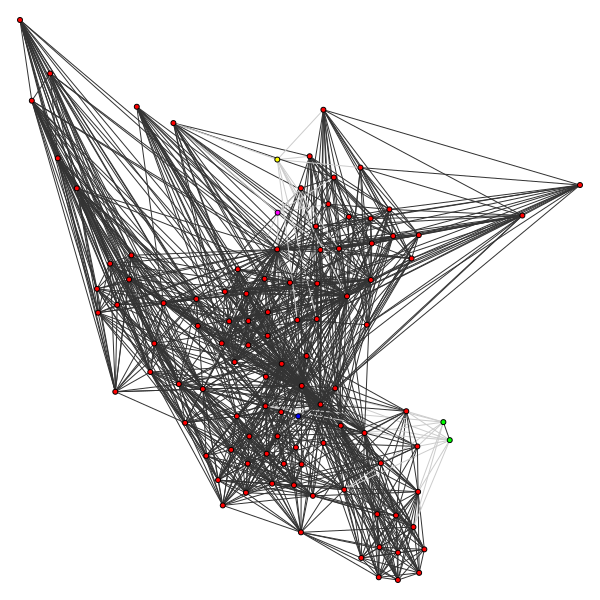

In [14]:
H = clusters.giant()
subclusters = leidenalg.CPMVertexPartition(H,
                                     weights='weight',
                                     resolution_parameter=0.1)
optimiser.optimise_partition(subclusters)
ig.plot(subclusters, vertex_size=5, vertex_label=None)

<div class="alert alert-info">
Try to find more subclusters by specifying a higher <code>resolution_parameter</code>.
</div>

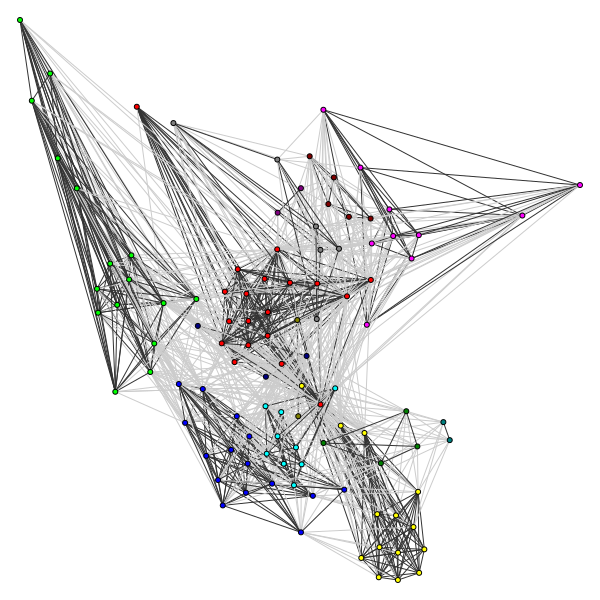

In [15]:
subclusters = leidenalg.CPMVertexPartition(H,
                                     weights='weight',
                                     resolution_parameter=0.5)
optimiser.optimise_partition(subclusters)
ig.plot(subclusters, vertex_size=5, vertex_label=None)

Modularity adapts itself to the network. In a sense that is convenient, because you then do not have to specify any parameters. On the other hand, it makes the definition of what a "cluster" is less clear.

CPM does not adapt itself to the network, and maintains the same defintion across different networks. That is convenient, because it brings more clarity to what we mean by a "cluster". Whenever you try to find subclusters using the same `resolution_parameter`, CPM should not find any subclusters. In practice, it may happen that CPM still finds some subclusters, in which case the original clusters were actually not the best possible. The Leiden algorithm can be run for multiple iterations, and with each iteration, the chances are smaller that CPM would find such subclusters. Modularity will always find subclusters, independent of the number of iterations.

<div class="alert alert-info">
Try to find optimise the partition with more iterations, as indicated below (<code>n_iterations=10</code>). Note that the function returns how much further it managed to improve the function, so that if it returns <code>0.0</code>, it means it couldn't find any further improvement. Execute the cell repeatedly. Does it return 0.0 after some time?
</div>

In [16]:
# Repeatedly press Ctrl-Enter
optimiser.optimise_partition(clusters, n_iterations=10)

299.6000000000001

Let us compare the clusters that we detected in Python with the clustering results from VOSviewer.

We can summarize the overall similarity to the partition based on the disciplines using the Normalised Mutual Information (NMI). The NMI varies between 0 and 1 and equals 1 if both are identical.

In [17]:
clusters.compare_to(clustering, method='nmi')

0.7997433359549486

There are some differences between the clustering from VOSviewer and the clusters we detected in Python. This will of course highly depend on what resolution parameter we have used for both results. One other important difference is that VOSviewer will by default use *normalized* weights. By default, it will divide the weight of a link by the expected weight, assuming that the total link weight of each node would remain the same, which is sometimes referred to as the *association strength*. We also perform this normalization here.

In [18]:
G_vosviewer.es['weight_normalized'] = [
    e['weight']/( G_vosviewer.vs[e.source]['weight<Total link strength>']*G_vosviewer.vs[e.target]['weight<Total link strength>'] / (2*sum(G_vosviewer.es['weight'])) ) 
    for e in G_vosviewer.es]

By default VOSviewer uses the default resolution of `1` for these normalized weights. If we now detect clusters using these weights, you will see that the result are more closely aligned to the VOSviewer results.

In [19]:
clusters = leidenalg.find_partition(G_vosviewer, leidenalg.CPMVertexPartition, 
                                       weights='weight_normalized', resolution_parameter=1,
                                       n_iterations=10)

clusters.compare_to(clustering, method='nmi')

0.9393115870250258

Now let us explore cluster detection a bit further.

<div class="alert alert-info">
    Vary the <code>resolution_parameter</code> when detecting clusters using the CPM method. What <code>resolution_parameter</code> seems reasonable to you, and why?
</div>

In [20]:
# What resolution_parameter is most suitable depends on your own interpretation of the results.
clusters = leidenalg.find_partition(G_vosviewer, leidenalg.CPMVertexPartition, 
                                       weights='weight_normalized', resolution_parameter=0.1,
                                       n_iterations=10)
ig.plot(clusters, vertex_size=5, vertex_label=None)

<div class="alert alert-info">
    Try to find a <code>resolution_parameter</code> such that the network separates in two large clusters (and some remaining small clusters). What is the cause of these two large clusters? (Hint: examine the author names)
</div>

In [21]:
clusters = leidenalg.find_partition(G_vosviewer, leidenalg.CPMVertexPartition, 
                                       weights='weight_normalized', resolution_parameter=0.01,
                                       n_iterations=10)
ig.plot(clusters, vertex_size=5, vertex_label=None)

In [22]:
print(G_vosviewer.vs[clusters[0]]['label'][:10])
print(G_vosviewer.vs[clusters[1]]['label'][:10])
# The difference is full author names versus only initials. The full author name is not always available for each journal.

['abatih, emmanuel', 'abatih, emmanuel nji', 'abdulla, salim', 'abebe, gemeda', 'ablordey, anthony', 'abongomera, charles', 'abouchadi, saloua', 'achan, jane', 'adams, emily r.', 'adaui, vanessa']
['abad, y.', 'abongomera, c.', 'abouchadi, s.', 'achiong, f.', 'adaui, v.', 'adem, e.', 'adriaensen, w.', 'affolabi, d.', 'agapito, j.', 'agudelo, e. londono']


<div class="alert alert-info">
Compare the co-authorship network that we created previously in Python to the network created in VOSviewer. What are the differences?
</div>

In [23]:
# This question actually cannot be correctly answered without more information. 
# The first big difference is of course the use of the full author names by VOSviewer in this case.
# The second big difference is that VOSviewer by default only includes authors with a certain minimum 
# number of publications.

# Document-term clustering

We will now use the same type of clustering technique that we used previously in a slightly different way. Instead of clustering a network, we will cluster a specific type of network, namely a bipartite network. This requires a slightly different (and more complicated) approach. More specifically, we will cluster a document-term network, where documents are linked to terms if those terms appear in a document.

We leave the task of extracting terms to VOSviewer, and simply import the resulting document-term network in Python. At the end of the notebook, you will find instructions how to extract the document-term network from VOSviewer yourself.

We read two files: (1) the `terms.txt` file, which simply contains the terms and their `id`; and (2) the `doc-term.txt` file, which contains which term occurs in which document. The `document id` refers to the line number of the WoS files that were read by VOSviewer. We will encounter this later.

In [24]:
terms_df = pd.read_csv('data-files/vosviewer/terms.txt', sep='\t', index_col='id')
doc_terms_df = pd.read_csv('data-files/vosviewer/doc-term.txt', sep='\t')

In this file, both the documents and the terms are using the same numbers, so that `igraph` cannot distinguish them (e.g. there is both a document `1` and a term `1`). We therefore create separate ids for both the documents and the terms.

In [25]:
doc_terms_df['document id'] = doc_terms_df['document id'].map(lambda x: str(x) + '-doc');
doc_terms_df['term id'] = doc_terms_df['term id'].map(lambda x: str(x) + '-term');

We can now create the network.

In [26]:
G_doc_term = ig.Graph.TupleList(
      edges=doc_terms_df.values,
      vertex_name_attr='id',
      directed=False
      )

This is a bipartite network, and we create a specific vertex attribute to indicate what the type is of the node: either a `doc` or a `term`.

In [27]:
G_doc_term.vs['type'] = ['doc' if 'doc' in v['id'] else 'term' for v in G_doc_term.vs]

Similar to the co-authorship network, VOSviewer typically normalizes the weights in a network by using the association strength, and we will also use that here.

In [28]:
G_doc_term.es['weight'] = [2.0*G_doc_term.ecount()/(G_doc_term.vs[e.source].degree()*G_doc_term.vs[e.target].degree()) 
                           for e in G_doc_term.es];

We now employ a small trick in order to do clustering in a bipartite network. We will not explain the full details, but it involves creating two empty networks. Please see the [documentation](https://leidenalg.readthedocs.io/en/latest/multiplex.html#bipartite) for a brief explanation of this approach.

In [29]:
H_docs = G_doc_term.subgraph_edges([], delete_vertices=False);
H_docs.vs['node_sizes'] = [1 if v['type'] == 'document' else 0 for v in H_docs.vs];

H_terms = G_doc_term.subgraph_edges([], delete_vertices=False);
H_terms.vs['node_sizes'] = [1 if v['type'] == 'term' else 0 for v in H_terms.vs];

In order to make this trick work, we now also have to create three separate partitions as follows. The `res_param` contains the resolution parameter that we previously used, and again plays a similar role. A value of around `0.35` seems to give reasonable results in this case.

In [30]:
res_param = 0.35
partition = leidenalg.CPMVertexPartition(G_doc_term, weights='weight', 
                                       resolution_parameter=res_param)

partition_docs = leidenalg.CPMVertexPartition(H_docs, weights='weight', 
                                       node_sizes=H_docs.vs['node_sizes'], 
                                       resolution_parameter=res_param)

partition_terms = leidenalg.CPMVertexPartition(H_terms, weights='weight', 
                                        node_sizes=H_terms.vs['node_sizes'], 
                                        resolution_parameter=res_param)

We are now ready to detect clusters, but we are going to use all three partitions we created. We do so by using the function `optimise_partition_multiplex` instead of the `optimise_partition` function that we used previously. We have to pass a list of partitions to that function. For the trick to work, we also need to pass the argument `layer_weights=[1,-1,-1]`, which assumes that the `partition` is the first element of the list that we pass.

In [31]:
optimiser = leidenalg.Optimiser()
optimiser.set_rng_seed(0)
optimiser.optimise_partition_multiplex(
              [partition, partition_docs, partition_terms],  
              layer_weights=[1,-1,-1], n_iterations=100)

3191330.9300641203

Now `partition` contains the clustering results (actually, `partition_docs` and `partition_terms` contain the identical clustering results). We extract the cluster membership of each node, and make it a new node attribute.

In [32]:
G_doc_term.vs['cluster'] = partition.membership
G_doc_term.vs['degree'] = G_doc_term.degree();

We will now create a so-called *projection* of the bipartite graph, which actually simply refers to the creation of a co-occurrence network.

In [33]:
G_doc_term.vs['type_int'] = [1 if v['type'] == 'term' else 0 for v in G_doc_term.vs];
G_terms = G_doc_term.bipartite_projection(types='type_int', which=1);
G_terms.simplify(combine_edges='sum');

G_terms.vs['id'] = [int(v['id'][:-5]) for v in G_terms.vs];
G_terms.vs['term'] = [terms_df.loc[v['id'],'term'] for v in G_terms.vs];

Now `G_terms` contains only terms and the co-occurrence between them. We will export this network to a file format so that we can read it back into VOSviewer. First, let us create the output directory (if necessary).

In [34]:
import os
output_dir = 'results/'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

Now we export the network `G_terms` in file format which is understandable to VOSviewer.

In [35]:
nodes_df = pd.DataFrame.from_dict({attr: G_terms.vs[attr] for attr in G_terms.vs.attributes()});
nodes_df['label'] = nodes_df['term'];
nodes_df['cluster'] += 1;
nodes_df['weight<Occurence>'] = nodes_df['degree'];
nodes_df = nodes_df.sort_values('id')
nodes_df[['id', 'label', 'cluster', 'weight<Occurence>']].to_csv(output_dir + 'map_vosviewer.txt', sep='\t', index=False);

edge_df = pd.DataFrame([(G_terms.vs[e.source]['id'], G_terms.vs[e.target]['id'], e['weight']) for e in G_terms.es],
                       columns=['source', 'target', 'weight']);
edge_df = edge_df.sort_values(['source', 'target']);
edge_df.to_csv(output_dir + 'network_vosviewer.txt', sep='\t', index=False, header=False);

The great benefit of doing the clustering in Python is that we now also have a clustering of the publications. This is something that is not possible in VOSviewer.

Let us first load the actual publication files which were used by VOSviewer (we have already done this in the previous notebook). As said, the `document id` refers to the line number of the WoS files that were read by VOSviewer, starting from `1`. We therefore also create a `document id` that is the same.

In [36]:
import glob
import csv
files = sorted(glob.glob('data-files/wos/tab-delimited/*.txt'))
publications_df = pd.concat(pd.read_csv(f, sep='\t', quoting=csv.QUOTE_NONE, 
                                        usecols=range(68), index_col='UT') for f in files)
publications_df['document id'] = range(1,publications_df.shape[0]+1)

Now let us create a dataframe from `G_doc_term` with all the information from the documents.

In [37]:
nodes_df = pd.DataFrame.from_dict({attr: G_doc_term.vs[attr] for attr in G_doc_term.vs.attributes()});
nodes_df = nodes_df[nodes_df['type'] == 'doc'];

Now we need back the original integer `document id`, instead of the identifiers we created `doc-1`, `doc-2`, etc... We can then use those `document id` to merge back the results with the original information from the publications.

In [38]:
nodes_df['document id'] = nodes_df['id'].str[:-4].astype(int);
publications_df = pd.merge(nodes_df[['document id', 'cluster']], publications_df, 
                           left_on='document id', right_on='document id')

Finally, for further inspection, we may want to export our results to a `.csv` file.

In [39]:
publications_df[['AU', 'PY', 'TI', 'SO', 'cluster']].to_csv(output_dir + 'publications_clustering.csv', 
                                                            index=False)

# Own analysis

<div class="alert alert-info">
Load your own data in VOSviewer and create a co-citation network of journals.
</div>

In [40]:
map_df = pd.read_csv('data-files/vosviewer/cocitation_map.txt', sep='\t')
network_df = pd.read_csv('data-files/vosviewer/cocitation_network.txt', sep='\t', 
                         names=['idA', 'idB', 'weight'])
G_cocitation = ig.Graph.DictList(
      vertices=map_df.to_dict('records'),
      edges=network_df.to_dict('records'),
      vertex_name_attr='id',
      edge_foreign_keys=('idA', 'idB'),
      directed=False
      )

<div class="alert alert-info">
Detect comunities in the journal co-citation network. What do you think the different clusters mean?
</div>

In [41]:
# Using the non-normalised weight does not seem to provide very meaningful clusters
clusters = leidenalg.find_partition(G_cocitation, leidenalg.CPMVertexPartition, 
                                       weights='weight', resolution_parameter=3,
                                       n_iterations=10)
ig.plot(clusters, vertex_size=5, vertex_label=None)

In [42]:
# Let us normalize the weights and then detect clusters again
G_cocitation.es['weight_normalized'] = [
    e['weight']/( G_cocitation.vs[e.source]['weight<Total link strength>']*G_cocitation.vs[e.target]['weight<Total link strength>'] / (2*sum(G_cocitation.es['weight'])) ) 
    for e in G_cocitation.es]

In [43]:
# These results seem to make more sense
clusters = leidenalg.find_partition(G_cocitation, leidenalg.CPMVertexPartition, 
                                       weights='weight_normalized', resolution_parameter=0.8,
                                       n_iterations=10)
ig.plot(clusters, vertex_size=5, vertex_label=None)

In [44]:
# Let us look at most central journals for cluster 0
H = clusters.subgraph(0)
H.vs['pagerank'] = H.pagerank(weights='weight')
sorted(H.vs, key=lambda v: v['pagerank'], reverse=True)[:5]
# Journals seem to be about tropical medicine

[igraph.Vertex(<igraph.Graph object at 0x0000025EA2923A98>, 88, {'id': 6670, 'label': 'plos neglect trop d', 'x': -0.0515, 'y': 0.0685, 'cluster': 3, 'weight<Links>': 240, 'weight<Total link strength>': 41846, 'weight<Citations>': 1209, 'pagerank': 0.059747145609048195}),
 igraph.Vertex(<igraph.Graph object at 0x0000025EA2923A98>, 57, {'id': 4670, 'label': 'j infect dis', 'x': -0.0585, 'y': -0.3996, 'cluster': 2, 'weight<Links>': 242, 'weight<Total link strength>': 24947, 'weight<Citations>': 760, 'pagerank': 0.03711010397251271}),
 igraph.Vertex(<igraph.Graph object at 0x0000025EA2923A98>, 109, {'id': 8575, 'label': 'vet parasitol', 'x': -0.5013, 'y': 0.5137, 'cluster': 3, 'weight<Links>': 204, 'weight<Total link strength>': 18981, 'weight<Citations>': 582, 'pagerank': 0.036099695143402014}),
 igraph.Vertex(<igraph.Graph object at 0x0000025EA2923A98>, 89, {'id': 6673, 'label': 'plos one', 'x': -0.0914, 'y': -0.0471, 'cluster': 2, 'weight<Links>': 244, 'weight<Total link strength>': 24

In [45]:
# Let us look at most central journals for cluster 1
H = clusters.subgraph(1)
H.vs['pagerank'] = H.pagerank(weights='weight')
sorted(H.vs, key=lambda v: v['pagerank'], reverse=True)[:5]
# Journals seem to be about parasitology

[igraph.Vertex(<igraph.Graph object at 0x0000025EA2A90138>, 92, {'id': 8350, 'label': 'trop med int health', 'x': 0.6359, 'y': 0.2123, 'cluster': 1, 'weight<Links>': 240, 'weight<Total link strength>': 44996, 'weight<Citations>': 1730, 'pagerank': 0.09424253540106263}),
 igraph.Vertex(<igraph.Graph object at 0x0000025EA2A90138>, 87, {'id': 8023, 'label': 't roy soc trop med h', 'x': 0.21899999999999997, 'y': 0.2127, 'cluster': 4, 'weight<Links>': 243, 'weight<Total link strength>': 52650, 'weight<Citations>': 1614, 'pagerank': 0.089974637209439}),
 igraph.Vertex(<igraph.Graph object at 0x0000025EA2A90138>, 60, {'id': 5124, 'label': 'lancet', 'x': 0.7363, 'y': -0.1275, 'cluster': 1, 'weight<Links>': 245, 'weight<Total link strength>': 32881, 'weight<Citations>': 1386, 'pagerank': 0.08223109305607247}),
 igraph.Vertex(<igraph.Graph object at 0x0000025EA2A90138>, 66, {'id': 5367, 'label': 'malaria j', 'x': -0.0138, 'y': 0.006999999999999999, 'cluster': 6, 'weight<Links>': 225, 'weight<Tot

<div class="alert alert-info">
    Load your own data in VOSviewer and create a term-map. Please take the following steps to create the term-map and extract the <code>terms.csv</code> file and the <code>doc-terms.csv</code> file.
    
<ol>
    <li>Open VOSviewer and press the button "Create...".</li>    
    <li>Choose "Create a map based on text data" and press "Next".</li>
    <li>Choose "Read data from bibliographic database files" and press "Next".</li>
    <li>Choose the "Web of Science" tab and select the files you have downloaded yourself and press "Next".</li>
    <li>Choose "Title and abstract fields" (the default) and press "Next".</li>
    <li>Choose "Binary counting" (the default) and press "Next".</li>
    <li>Leave the default threshold of 10 and press "Next".</li>
    <li>Leave the default number of terms to be selected and press "Next".</li>
</ol>

VOSviewer will now calculate the "relevance" scores. When it is done, you will be shown a list of terms together with the number of their occurrences and the relevance scores. Please follow the following remaining steps.

<ol start=9>
    <li>On the list of terms, click-right, and choose "Export selected terms...". Choose an appropriate file name (<code>terms.txt</code>) and make sure you choose an appropriate directory and then press "Export".</li>
    <li>On the list of terms, click-right, and choose "Export document-term relations...". Choose an appropriate file name (<code>doc-terms.txt</code>) and make sure you choose an appropriate directory and then press "Export".</li>
</ol>
</div>

<div class="alert alert-info">
    Load the <code>terms.csv</code> file and the <code>doc-terms.csv</code> files. Detect the clusters in this bipartite network, as explained above.
</div>

In [46]:
# Read data
terms_df = pd.read_csv('data-files/vosviewer/terms.txt', sep='\t', index_col='id')
doc_terms_df = pd.read_csv('data-files/vosviewer/doc-term.txt', sep='\t')
# Create proper node identifiers
doc_terms_df['document id'] = doc_terms_df['document id'].map(lambda x: str(x) + '-doc');
doc_terms_df['term id'] = doc_terms_df['term id'].map(lambda x: str(x) + '-term');

# Create the network
G_doc_term = ig.Graph.TupleList(
      edges=doc_terms_df.values,
      vertex_name_attr='id',
      directed=False
      )
G_doc_term.vs['type'] = ['doc' if 'doc' in v['id'] else 'term' for v in G_doc_term.vs]
G_doc_term.es['weight'] = [2.0*G_doc_term.ecount()/(G_doc_term.vs[e.source].degree()*G_doc_term.vs[e.target].degree()) 
                           for e in G_doc_term.es];

# Create the support networks to do bipartite clustering
H_docs = G_doc_term.subgraph_edges([], delete_vertices=False);
H_docs.vs['node_sizes'] = [1 if v['type'] == 'document' else 0 for v in H_docs.vs];

H_terms = G_doc_term.subgraph_edges([], delete_vertices=False);
H_terms.vs['node_sizes'] = [1 if v['type'] == 'term' else 0 for v in H_terms.vs];

# Create the support partitions to do bipartite clustering
res_param = 0.35
partition = leidenalg.CPMVertexPartition(G_doc_term, weights='weight', 
                                       resolution_parameter=res_param)

partition_docs = leidenalg.CPMVertexPartition(H_docs, weights='weight', 
                                       node_sizes=H_docs.vs['node_sizes'], 
                                       resolution_parameter=res_param)

partition_terms = leidenalg.CPMVertexPartition(H_terms, weights='weight', 
                                        node_sizes=H_terms.vs['node_sizes'], 
                                        resolution_parameter=res_param)

# Detect bipartite clusters
optimiser = leidenalg.Optimiser()
optimiser.set_rng_seed(0)
optimiser.optimise_partition_multiplex(
              [partition, partition_docs, partition_terms],  
              layer_weights=[1,-1,-1], n_iterations=100)

# Indicate clusters in network
G_doc_term.vs['cluster'] = partition.membership
G_doc_term.vs['degree'] = G_doc_term.degree();

Output resulting term map

In [47]:
# Project bipartite network as terms
G_doc_term.vs['type_int'] = [1 if v['type'] == 'term' else 0 for v in G_doc_term.vs];
G_terms = G_doc_term.bipartite_projection(types='type_int', which=1);
G_terms.simplify(combine_edges='sum');

G_terms.vs['id'] = [int(v['id'][:-5]) for v in G_terms.vs];
G_terms.vs['term'] = [terms_df.loc[v['id'],'term'] for v in G_terms.vs];

# Output term network
output_dir = 'results/'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

nodes_df = pd.DataFrame.from_dict({attr: G_terms.vs[attr] for attr in G_terms.vs.attributes()});
nodes_df['label'] = nodes_df['term'];
nodes_df['cluster'] += 1;
nodes_df['weight<Occurence>'] = nodes_df['degree'];
nodes_df = nodes_df.sort_values('id')
nodes_df[['id', 'label', 'cluster', 'weight<Occurence>']].to_csv(output_dir + 'term_map_vosviewer.txt', sep='\t', index=False);

edge_df = pd.DataFrame([(G_terms.vs[e.source]['id'], G_terms.vs[e.target]['id'], e['weight']) for e in G_terms.es],
                       columns=['source', 'target', 'weight']);
edge_df = edge_df.sort_values(['source', 'target']);
edge_df.to_csv(output_dir + 'term_network_vosviewer.txt', sep='\t', index=False, header=False);

Output document clustering

In [48]:
import glob
import csv
files = sorted(glob.glob('data-files/wos/tab-delimited/*.txt'))
publications_df = pd.concat(pd.read_csv(f, sep='\t', quoting=csv.QUOTE_NONE, 
                                        usecols=range(68), index_col='UT') for f in files)
publications_df['document id'] = range(1,publications_df.shape[0]+1)

# Create dataframe
nodes_df = pd.DataFrame.from_dict({attr: G_doc_term.vs[attr] for attr in G_doc_term.vs.attributes()});
nodes_df = nodes_df[nodes_df['type'] == 'doc'];

nodes_df['document id'] = nodes_df['id'].str[:-4].astype(int);
publications_df = pd.merge(nodes_df[['document id', 'cluster']], publications_df, 
                           left_on='document id', right_on='document id')

# Export to csv
publications_df[['AU', 'PY', 'TI', 'SO', 'cluster']].to_csv(output_dir + 'publications_clustering.csv', 
                                                            index=False)

<div class="alert alert-info">
    Compare the results to the clusters you can detect immediately in VOSviewer itself. Are they similar or not?
</div>

In [49]:
# This should be done in VOSviewer.
# Load the term map that is created in Python, and compare this to the term map that you
# created yourself in VOSviewer.

<div class="alert alert-info">
    Try to identify the main topic for the largest few clusters on the basis of the terms in the term map. Does that match well with the publications in the same cluster? Do you see any discrepancies?
</div>

In [50]:
# First use the terms in the cluster to get some idea of the topics.
# Then check the csv file (publications_clustering.csv) to check your interpretation based on the titles of the
# publications.